# Parallel coordinates plot 

this is a more compact way to visualize the difference between data in a single plot

In [21]:
import Pkg
Pkg.activate(@__DIR__)

  Activating project at `~/Desktop/git_projects/Causal sets/QuantumGrav-usage/analysis`


In [22]:
using CairoMakie
using AlgebraOfGraphics
using DataFrames 
using CSV 
using StatsBase

set_theme!(theme_latexfonts()) # other themes here: https://docs.makie.org/dev/explanations/theming/predefined_themes#Predefined-themes

read data, put into one dataframe

In [170]:
manifold_simply_connected_data = CSV.File("/Users/fabianwagner/Desktop/git_projects/Causal sets/data/analysis/statistics/manifold_simply_connected.csv") |> DataFrame 
manifold_non_simply_connected_data = CSV.File("/Users/fabianwagner/Desktop/git_projects/Causal sets/data/analysis/statistics/manifold_non_simply_connected.csv") |> DataFrame 
grid_data = CSV.File("/Users/fabianwagner/Desktop/git_projects/Causal sets/data/analysis/statistics/grid.csv") |> DataFrame 
random_data = CSV.File("/Users/fabianwagner/Desktop/git_projects/Causal sets/data/analysis/statistics/random.csv") |> DataFrame 
layered_data = CSV.File("/Users/fabianwagner/Desktop/git_projects/Causal sets/data/analysis/statistics/layered.csv") |> DataFrame 
destroyed_data = CSV.File("/Users/fabianwagner/Desktop/git_projects/Causal sets/data/analysis/statistics/destroyed.csv") |> DataFrame 
merged_data = CSV.File("/Users/fabianwagner/Desktop/git_projects/Causal sets/data/analysis/statistics/merged.csv") |> DataFrame 

grid_data = filter(row -> row.lattice == "quadratic", grid_data)

random_data[!, "kind"] .= "random"
manifold_simply_connected_data[!, "kind"] .= "manifold_simply_connected"
manifold_non_simply_connected_data[!, "kind"] .= "manifold_non_simply_connected"
grid_data[!, "kind"] .= "grid"
grid_data[!, "lattice"] = string.(grid_data.lattice)
destroyed_data[!, "kind"] .= "destroyed"
merged_data[!, "kind"] .= "merged"
layered_data[!, "kind"] .= "layered"
layered_data[!, "num_layers"] = layered_data.num_layers

columns = intersect(names(random_data), names(manifold_simply_connected_data), names(manifold_non_simply_connected_data), names(grid_data), names(destroyed_data), names(merged_data), names(layered_data))
columns_grid = names(grid_data)
columns_layered = names(layered_data)

df = vcat(manifold_non_simply_connected_data[!, columns], manifold_simply_connected_data[!, columns], grid_data[!, columns], destroyed_data[!, columns], merged_data[!, columns], random_data[!, columns], layered_data[!, columns])
df_grid = grid_data[!, columns_grid];
df_layered = layered_data[!, columns_layered];

function for equalizing the scale of the data to put them on one axis

In [138]:
function transform_to_scale!(col)
    min_val = minimum(col)
    max_val = maximum(col)
    if abs(max_val - min_val) < 1e-3
        if abs(max_val) < 1e-3
            return col
        end
        return col ./ max_val
    else
        return (col .- min_val) ./ (max_val - min_val)
    end
end

transform_to_scale! (generic function with 1 method)

In [179]:
normalized_df = deepcopy(df)
for col in names(df)
    if col != "connectivity" && eltype(df[!, col]) <: Number
        c = transform_to_scale!(normalized_df[!, col])
        normalized_df[!, col] = c
    end
end

normalized_df_grid = deepcopy(df_grid)
for col in names(df_grid)
    if col != "connectivity" && eltype(df_grid[!, col]) <: Number
        c = transform_to_scale!(normalized_df_grid[!, col])
        normalized_df_grid[!, col] = c
    end
end

normalized_df_layered = deepcopy(df_layered)
for col in names(df_layered)
    if col != "num_layers" && col != "connectivity" && eltype(df_layered[!, col]) <: Number
        c = transform_to_scale!(normalized_df_layered[!, col])
        normalized_df_layered[!, col] = c
    end
end

add a row id column

In [180]:
normalized_df[!, :id] = 1:size(df)[1]

normalized_df_grid[!, :id] = 1:size(df_grid)[1]

normalized_df_layered[!, :id] = 1:size(df_layered)[1]

1:1000

sample data for plotting b/c 20k doesn´t help visually

In [141]:
n_sample = 5000

5000

In [181]:
idxs = sample(1:size(df)[1], n_sample) # uniform sampling without replacement

idxs_grid = sample(1:size(df_grid)[1], n_sample) # uniform sampling without replacement

idxs_layered = sample(1:size(df_grid)[1], n_sample) # uniform sampling without replacement

5000-element Vector{Int64}:
   2
   5
  45
 104
  19
 159
  51
  76
 143
 143
   ⋮
  86
 174
 194
 128
  37
 187
  12
 201
  88

make long-form dataframe

In [182]:

# Reshape to long format: each variable as a "dimension"
normalized_df_long = stack(normalized_df[idxs, :], Not(:id, :kind, :n), variable_name=:variable, value_name=:value)
normalized_df_long_grid = stack(normalized_df_grid[idxs_grid, :], Not(:id, :lattice, :n), variable_name=:variable, value_name=:value)
normalized_df_long_layered = stack(normalized_df_layered[idxs_layered, :], Not(:id, :num_layers, :n), variable_name=:variable, value_name=:value)


Row,n,num_layers,id,variable,value
,Float64,Int64,Int64,String,Any
1,1.0,3,2,connectivity,0.440931
2,1.0,17,5,connectivity,0.899755
3,1.0,4,45,connectivity,0.615748
4,1.0,22,104,connectivity,0.904075
5,1.0,6,19,connectivity,0.415931
6,1.0,14,159,connectivity,0.818321
7,1.0,21,51,connectivity,0.851256
8,1.0,8,76,connectivity,0.791268
9,1.0,20,143,connectivity,0.842065


In [191]:
variables = unique(normalized_df_long.variable)

variables_grid = unique(normalized_df_long_grid.variable)

variables_layered = unique(normalized_df_long_layered.variable)

90-element Vector{String}:
 "connectivity"
 "in_degree_min"
 "in_degree_max"
 "in_degree_mean"
 "in_degree_q25"
 "in_degree_q75"
 "in_degree_median"
 "out_degree_min"
 "out_degree_max"
 "out_degree_mean"
 ⋮
 "chain_cardinalities_2_median"
 "chain_cardinalities_3_min"
 "chain_cardinalities_3_max"
 "chain_cardinalities_3_mean"
 "chain_cardinalities_3_q25"
 "chain_cardinalities_3_q75"
 "chain_cardinalities_3_median"
 "standard_dev"
 "kind"

In [145]:
println.(variables)

connectivity
in_degree_min
in_degree_max
in_degree_mean
in_degree_q25
in_degree_q75
in_degree_median
out_degree_min
out_degree_max
out_degree_mean
out_degree_q25
out_degree_q75
out_degree_median
in_degree_min_link
in_degree_max_link
in_degree_mean_link
in_degree_q25_link
in_degree_q75_link
in_degree_median_link
out_degree_min_link
out_degree_max_link
out_degree_mean_link
out_degree_q25_link
out_degree_q75_link
out_degree_median_link
max_pathlen_min
max_pathlen_max
max_pathlen_mean
max_pathlen_q25
max_pathlen_q75
max_pathlen_median
max_pathlen_min_link
max_pathlen_max_link
max_pathlen_mean_link
max_pathlen_q25_link
max_pathlen_q75_link
max_pathlen_median_link
num_sources
num_sinks
num_sources_link
num_sinks_link
num_zero_ev_in
num_zero_ev_out
ev_in_min
ev_in_max
ev_in_mean
ev_in_q25
ev_in_q75
ev_in_median
ev_out_min
ev_out_max
ev_out_mean
ev_out_q25
ev_out_q75
ev_out_median
num_zero_ev_in_link
num_zero_ev_out_link
ev_in_min_link
ev_in_max_link
ev_in_mean_link
ev_in_q25_link
ev_in_q75_li

88-element Vector{Nothing}:
 nothing
 nothing
 nothing
 nothing
 nothing
 nothing
 nothing
 nothing
 nothing
 nothing
 ⋮
 nothing
 nothing
 nothing
 nothing
 nothing
 nothing
 nothing
 nothing
 nothing

In [202]:
variables_reduced = [
    "connectivity",
    #"relation_numbers", 
    "in_degree_median", 
    "out_degree_median", 
    "in_degree_median_link", 
    #"out_degree_median_link", 
    "max_pathlen_median", 
    "max_pathlen_max", 
    #"max_pathlen_median_link", 
    "num_zero_ev_in",
    #"num_zero_ev_out",
    "num_zero_ev_in_link", 
    #"num_zero_ev_out_link", 
    "ev_in_median", 
    "ev_out_median", 
    "ev_in_median_link", 
    #"ev_out_median_link", 
    "cardinalities_median", 
    "chain_cardinalities_2_median",
    "chain_cardinalities_3_median", 
]

14-element Vector{String}:
 "connectivity"
 "in_degree_median"
 "out_degree_median"
 "in_degree_median_link"
 "max_pathlen_median"
 "max_pathlen_max"
 "num_zero_ev_in"
 "num_zero_ev_in_link"
 "ev_in_median"
 "ev_out_median"
 "ev_in_median_link"
 "cardinalities_median"
 "chain_cardinalities_2_median"
 "chain_cardinalities_3_median"

Parallel coordinates plot: https://en.wikipedia.org/wiki/Parallel_coordinates
- each row is a sample 
- x: the data variables 
- y: the values per variable 

==> get as many parallel vertical axes as there are data variables, plot the values per variable on each axis, and connect the ones belonging to the same sample by a line. color by kind (random, manifoldlike)

==> see how they cluster variable by variable

use AlgebraOfGraphics.jl here --> based on Grammar of Graphics like R's ggplot2. 

In [203]:
pp_specs(df) = data(df) * mapping(
    :variable => sorter(variables),        # x axis: variable name --> sort to make sure we don´t get lines crossing each other
    :value,            # y axis: value
    color=:kind,       # color by kind: random, manifold
    group=:id        # connect points belonging to same id
) * (visual(Lines, linewidth=0.5) + visual(Scatter, alpha = 0.3, markersize = 7)) # 2 layers: lines connecting the values of each sample, scatter to highlight them. 

pp_specs_grid(df_grid) = data(df_grid) * mapping(
    :variable => sorter(variables_grid),        # x axis: variable name --> sort to make sure we don´t get lines crossing each other
    :value,            # y axis: value
    color=:lattice,       # color by kind: random, manifold
    group=:id        # connect points belonging to same id
) * (visual(Lines, linewidth=0.5) + visual(Scatter, alpha = 0.3, markersize = 7)) # 2 layers: lines connecting the values of each sample, scatter to highlight them. 

pp_specs_layered(df_layered) = data(df_layered) * mapping(
    :variable => sorter(variables_layered),        # x axis: variable name --> sort to make sure we don´t get lines crossing each other
    :value,            # y axis: value
    color=:num_layers,       # color by kind: random, manifold
    group=:id        # connect points belonging to same id
) * (visual(Lines, linewidth=0.5) + visual(Scatter, alpha = 0.3, markersize = 7)) # 2 layers: lines connecting the values of each sample, scatter to highlight them. 



pp_specs_layered (generic function with 1 method)

In [207]:
layered= pp_specs(filter(row -> row.kind == "layered" && row.variable in variables_reduced, normalized_df_long))
random= pp_specs(filter(row -> row.kind == "random" && row.variable in variables_reduced, normalized_df_long))
manifold_simply_connected = pp_specs(filter(row -> row.kind == "manifold_simply_connected" && row.variable in variables_reduced, normalized_df_long))
manifold_non_simply_connected = pp_specs(filter(row -> row.kind == "manifold_non_simply_connected" && row.variable in variables_reduced, normalized_df_long))
grid = pp_specs(filter(row -> row.kind == "grid" && row.variable in variables_reduced, normalized_df_long))
destroyed = pp_specs(filter(row -> row.kind == "destroyed" && row.variable in variables_reduced, normalized_df_long))
merged = pp_specs(filter(row -> row.kind == "merged" && row.variable in variables_reduced, normalized_df_long))

grid_quadratic = pp_specs_grid(filter(row -> row.lattice == "quadratic" && row.variable in variables_reduced, normalized_df_long_grid))
grid_rhombic = pp_specs_grid(filter(row -> row.lattice == "rhombic" && row.variable in variables_reduced, normalized_df_long_grid))
grid_rectangular = pp_specs_grid(filter(row -> row.lattice == "rectangular" && row.variable in variables_reduced, normalized_df_long_grid))
grid_hexagonal = pp_specs_grid(filter(row -> row.lattice == "hexagonal" && row.variable in variables_reduced, normalized_df_long_grid))
grid_oblique = pp_specs_grid(filter(row -> row.lattice == "oblique" && row.variable in variables_reduced, normalized_df_long_grid))

layered_by_layer = pp_specs_layered(filter(row -> row.variable in variables_reduced, normalized_df_long_layered))

Layers with 2 elements:
  Layer 1
    transformation: AlgebraOfGraphics.Visual(Lines, {:linewidth = 0.5})
    data: AlgebraOfGraphics.Columns{DataFrames.DataFrameColumns{DataFrame}}
    positional:
      1: :variable => AlgebraOfGraphics.Renamer{Vector{String}, Vector{String}}(["connectivity", "in_degree_min", "in_degree_max", "in_degree_mean", "in_degree_q25", "in_degree_q75", "in_degree_median", "out_degree_min", "out_degree_max", "out_degree_mean"  …  "chain_cardinalities_2_q75", "chain_cardinalities_2_median", "chain_cardinalities_3_min", "chain_cardinalities_3_max", "chain_cardinalities_3_mean", "chain_cardinalities_3_q25", "chain_cardinalities_3_q75", "chain_cardinalities_3_median", "standard_dev", "kind"], ["connectivity", "in_degree_min", "in_degree_max", "in_degree_mean", "in_degree_q25", "in_degree_q75", "in_degree_median", "out_degree_min", "out_degree_max", "out_degree_mean"  …  "chain_cardinalities_2_q75", "chain_cardinalities_2_median", "chain_cardinalities_3_min", "chain

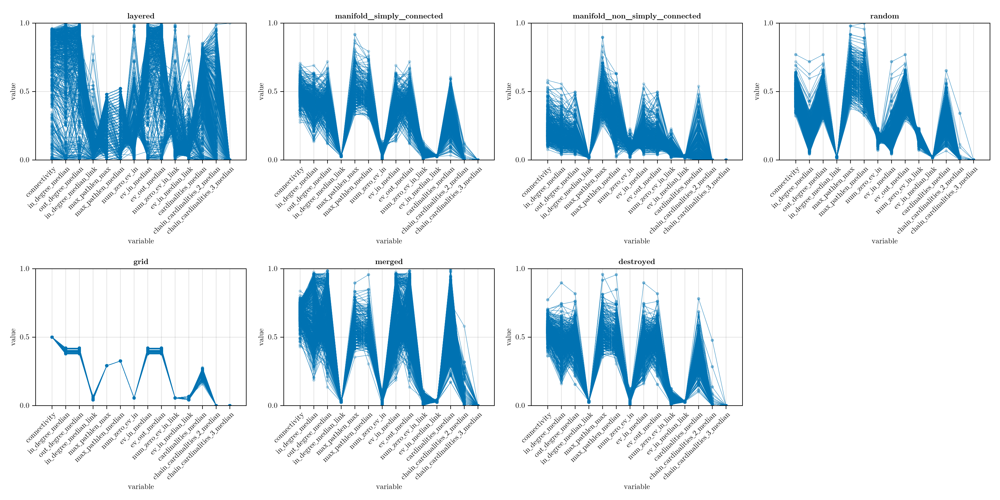

In [208]:
f = Figure(title="parallel coordinates", size=(1600, 800), fontsize =12)
layered_plot = draw!(f[1,1], layered, axis=(xticklabelrotation=pi/4, title="layered", limits = (nothing, (0.0, 1.0))))
manifold_simply_connected_plot = draw!(f[1,2], manifold_simply_connected, axis=(xticklabelrotation=pi/4, title="manifold_simply_connected", limits = (nothing, (0.0, 1.0))))
manifold_non_simply_connected_plot = draw!(f[1,3], manifold_non_simply_connected, axis=(xticklabelrotation=pi/4, title="manifold_non_simply_connected", limits = (nothing, (0.0, 1.0))))
random_plot = draw!(f[1,4], random, axis=(xticklabelrotation=pi/4, title="random", limits = (nothing, (0.0, 1.0))))
grid_plot = draw!(f[2,1], grid, axis=(xticklabelrotation=pi/4, title="grid", limits = (nothing, (0.0, 1.0))))
merged_plot = draw!(f[2,2], merged, axis=(xticklabelrotation=pi/4, title="merged", limits = (nothing, (0.0, 1.0))))
destroyed_plot = draw!(f[2,3], destroyed, axis=(xticklabelrotation=pi/4, title="destroyed", limits = (nothing, (0.0, 1.0))))
f

In [136]:
AlgebraOfGraphics.save("./parallel_coordinates_classes_reduced.png", f)

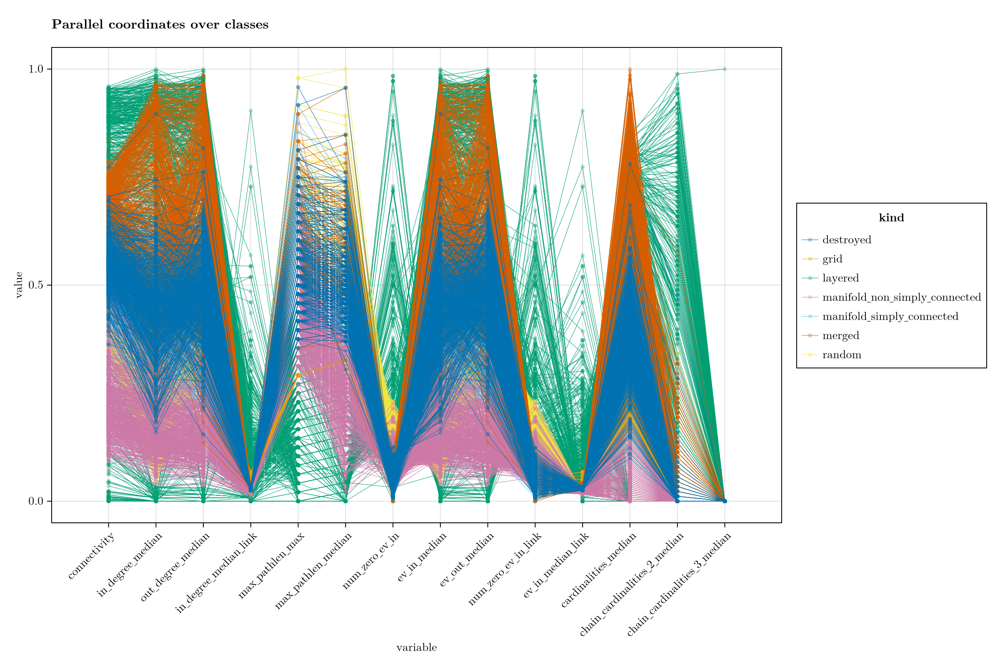

In [209]:
f = draw(sum([layered, random, manifold_simply_connected, manifold_non_simply_connected, grid, merged,destroyed]),  figure=(title="Parallel coordinates over classes", size=(1200, 800)), axis=(xticklabelrotation=pi/4,))

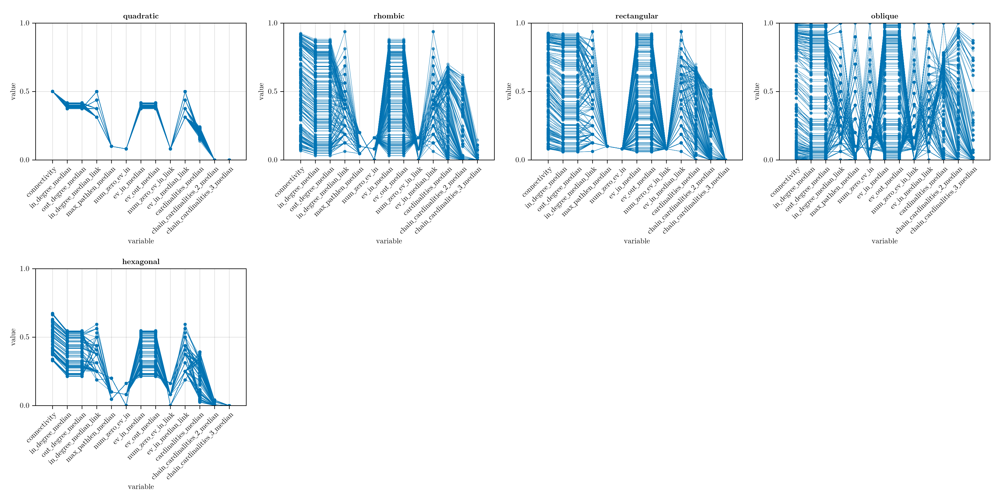

In [135]:
f = Figure(title="parallel coordinates", size=(1600, 800), fontsize =12)
quadratic_plot = draw!(f[1,1], grid_quadratic, axis=(xticklabelrotation=pi/4, title="quadratic", limits = (nothing, (0.0, 1.0))))
rhombic_plot = draw!(f[1,2], grid_rhombic, axis=(xticklabelrotation=pi/4, title="rhombic", limits = (nothing, (0.0, 1.0))))
rectangular_plot = draw!(f[1,3], grid_rectangular, axis=(xticklabelrotation=pi/4, title="rectangular", limits = (nothing, (0.0, 1.0))))
oblique_plot = draw!(f[1,4], grid_oblique, axis=(xticklabelrotation=pi/4, title="oblique", limits = (nothing, (0.0, 1.0))))
hexagonal_plot = draw!(f[2,1], grid_hexagonal, axis=(xticklabelrotation=pi/4, title="hexagonal", limits = (nothing, (0.0, 1.0))))
f

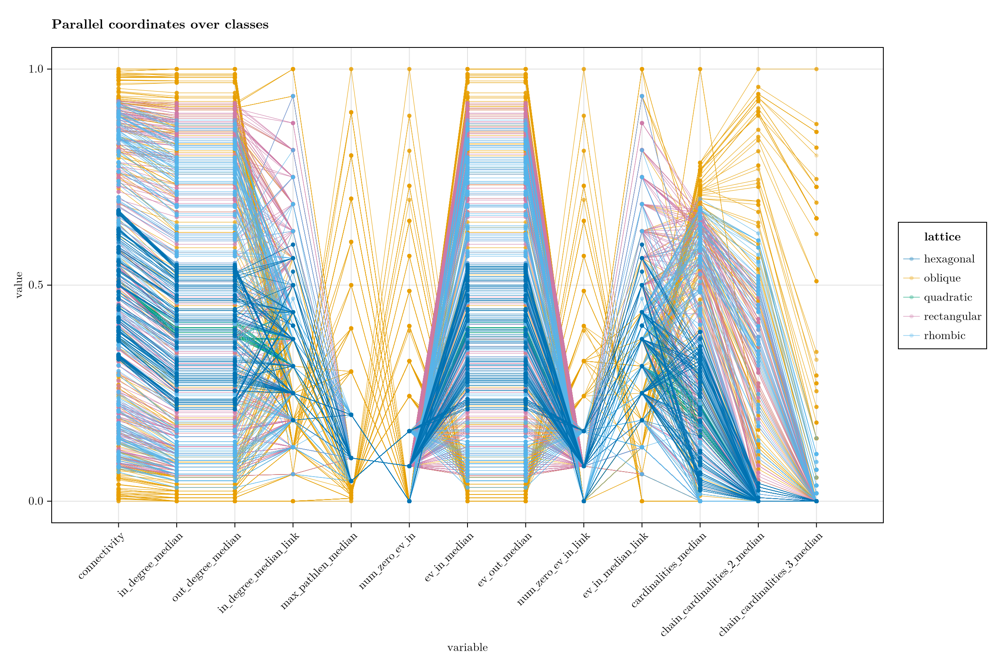

In [133]:
f = draw(sum([grid_oblique,grid_quadratic, grid_rectangular, grid_rhombic, grid_hexagonal]),  figure=(title="Parallel coordinates over classes", size=(1200, 800)), axis=(xticklabelrotation=pi/4,))

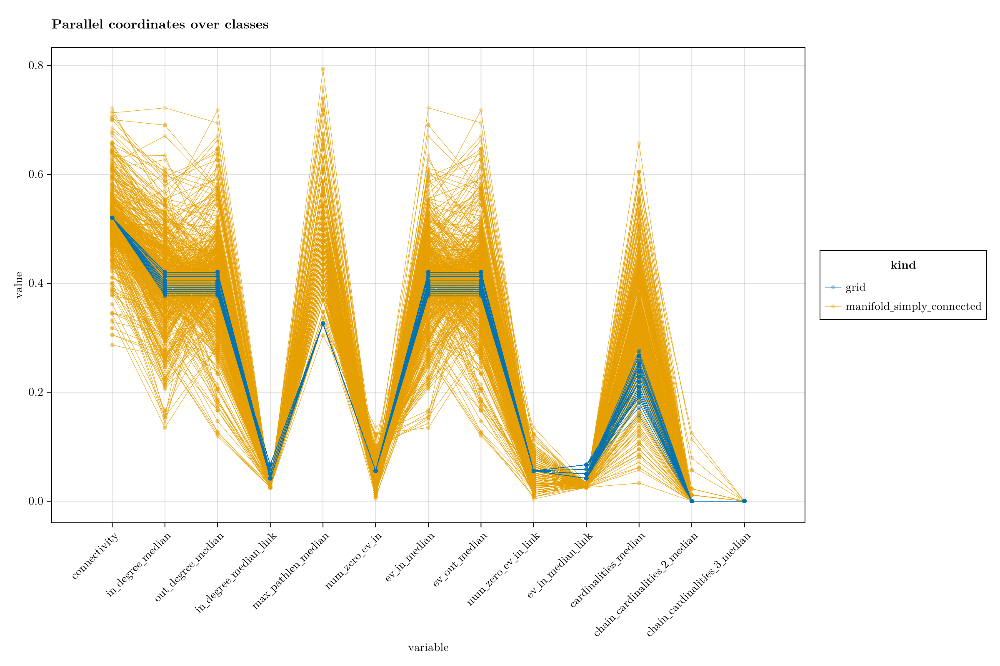

In [164]:
f = draw(sum([manifold_simply_connected, grid]),  figure=(title="Parallel coordinates over classes", size=(1200, 800)), axis=(xticklabelrotation=pi/4,))

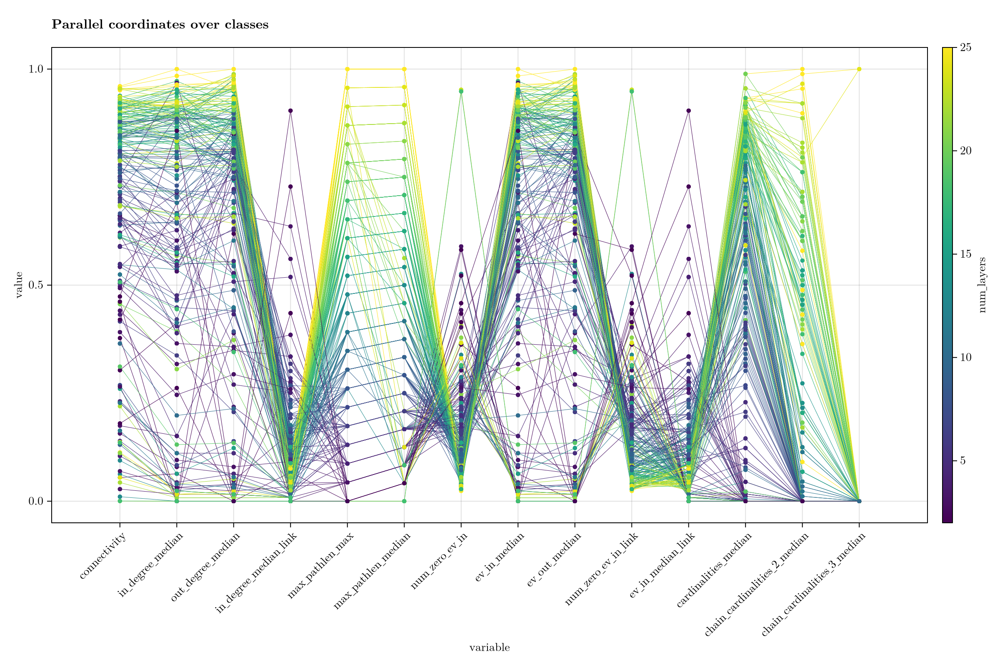

In [211]:
f = draw(sum([layered_by_layer]),  figure=(title="Parallel coordinates over classes", size=(1200, 800)), axis=(xticklabelrotation=pi/4,))

In [18]:
normalized_df_long_reduced = filter(row -> row.variable in variables_reduced, normalized_df_long)

Row,n,kind,id,variable,value
,Float64,String,Int64,String,Float64
1,0.143982,manifold_simply_connected,9806,connectivity,0.520669
2,0.333521,layered,10283,connectivity,0.846001
3,0.143982,manifold_simply_connected,5599,connectivity,0.507653
4,0.143982,manifold_simply_connected,6773,connectivity,0.506
5,0.143982,manifold_simply_connected,4953,connectivity,0.531787
6,0.143982,manifold_simply_connected,7481,connectivity,0.507582
7,0.143982,manifold_simply_connected,3293,connectivity,0.538433
8,0.143982,manifold_simply_connected,8979,connectivity,0.483763
9,0.143982,manifold_simply_connected,4991,connectivity,0.51122


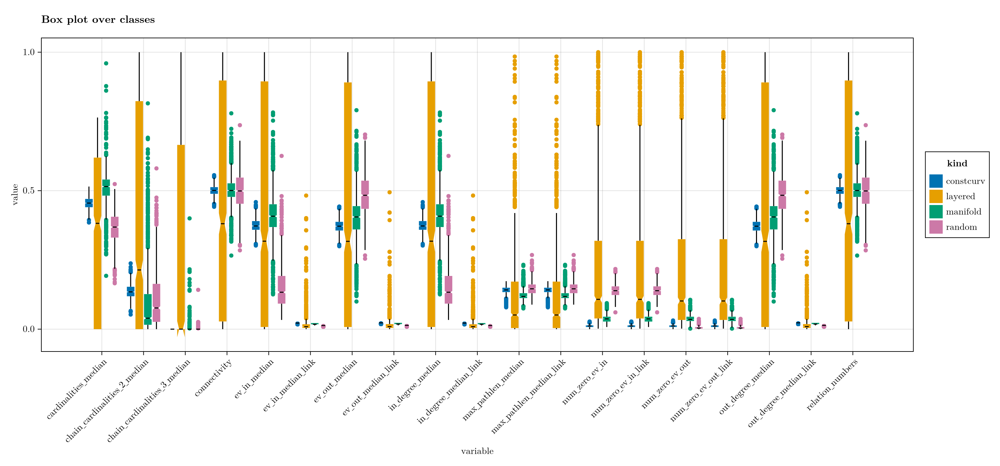

In [ ]:
specs = data(normalized_df_long_reduced) * mapping(:variable, :value, color = :kind, dodge=:kind) * visual(BoxPlot, show_notch=true)
f = draw(specs, figure=(title="Box plot over classes", size=(1500, 700)), axis=(xticklabelrotation=pi/4,))


In [ ]:
AlgebraOfGraphics.save("./boxplot_classes_reduced_layered.png", f)


In [ ]:
box_specs(df) = data(df) * mapping(
    :variable => sorter(variables),        # x axis: variable name --> sort to make sure we don´t get lines crossing each other
    :value,            # y axis: value
    color=:kind,       # color by kind: random, manifold
    dodge=:kind
) * visual(BoxPlot, show_notch=true)

layered= box_specs(filter(row -> row.kind == "layered" && row.variable in variables_reduced, normalized_df_long))
random= box_specs(filter(row -> row.kind == "random" && row.variable in variables_reduced, normalized_df_long))
manifold_simply_connected = box_specs(filter(row -> row.kind == "manifold_simply_connected" && row.variable in variables_reduced, normalized_df_long))
manifold_non_simply_connected = box_specs(filter(row -> row.kind == "manifold_non_simply_connected" && row.variable in variables_reduced, normalized_df_long))
grid = box_specs(filter(row -> row.kind == "grid" && row.variable in variables_reduced, normalized_df_long))
merged = box_specs(filter(row -> row.kind == "merged" && row.variable in variables_reduced, normalized_df_long))
destroyed = box_specs(filter(row -> row.kind == "destroyed" && row.variable in variables_reduced, normalized_df_long))



Layer 
  transformation: AlgebraOfGraphics.Visual(BoxPlot, {:show_notch = true})
  data: AlgebraOfGraphics.Columns{DataFrames.DataFrameColumns{DataFrame}}
  positional:
    1: :variable => AlgebraOfGraphics.Renamer{Vector{String}, Vector{String}}(["connectivity", "in_degree_min", "in_degree_max", "in_degree_mean", "in_degree_q25", "in_degree_q75", "in_degree_median", "out_degree_min", "out_degree_max", "out_degree_mean"  …  "chain_cardinalities_2_mean", "chain_cardinalities_2_q25", "chain_cardinalities_2_q75", "chain_cardinalities_2_median", "chain_cardinalities_3_min", "chain_cardinalities_3_max", "chain_cardinalities_3_mean", "chain_cardinalities_3_q25", "chain_cardinalities_3_q75", "chain_cardinalities_3_median"], ["connectivity", "in_degree_min", "in_degree_max", "in_degree_mean", "in_degree_q25", "in_degree_q75", "in_degree_median", "out_degree_min", "out_degree_max", "out_degree_mean"  …  "chain_cardinalities_2_mean", "chain_cardinalities_2_q25", "chain_cardinalities_2_q75", "cha

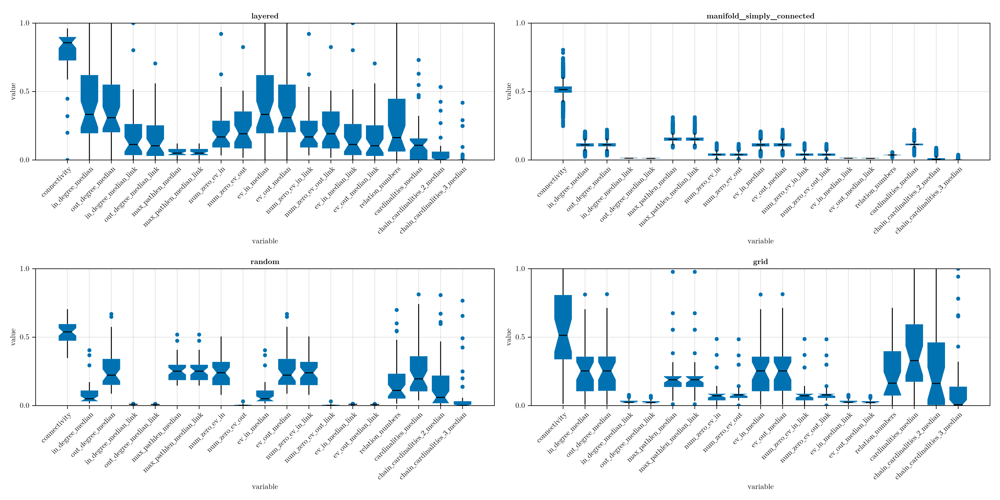

In [ ]:
f = Figure(title="boxplot", size=(1600, 800), fontsize =12)
layered_plot = draw!(f[1,1], layered, axis=(xticklabelrotation=pi/4, title="layered", limits = (nothing, (0.0, 1.0))))
manifold_simply_connected_plot = draw!(f[1,2], manifold_simply_connected, axis=(xticklabelrotation=pi/4, title="manifold_simply_connected", limits = (nothing, (0.0, 1.0))))
manifold_non_simply_connected_plot = draw!(f[1,2], manifold_non_simply_connected, axis=(xticklabelrotation=pi/4, title="manifold_non_simply_connected", limits = 
random_plot = draw!(f[2,1], random, axis=(xticklabelrotation=pi/4, title="random", limits = (nothing, (0.0, 1.0))))
grid_plot = draw!(f[2,2], grid, axis=(xticklabelrotation=pi/4, title="grid", limits = (nothing, (0.0, 1.0))))
merged_plot = draw!(f[2,2], merged, axis=(xticklabelrotation=pi/4, title="merged", limits = (nothing, (0.0, 1.0))))
destroyed = draw!(f[2,2], destroyed, axis=(xticklabelrotation=pi/4, title="destroyed", limits = (nothing, (0.0, 1.0))))
f

In [ ]:
AlgebraOfGraphics.save("./boxplot_classes_reduced.png", f)

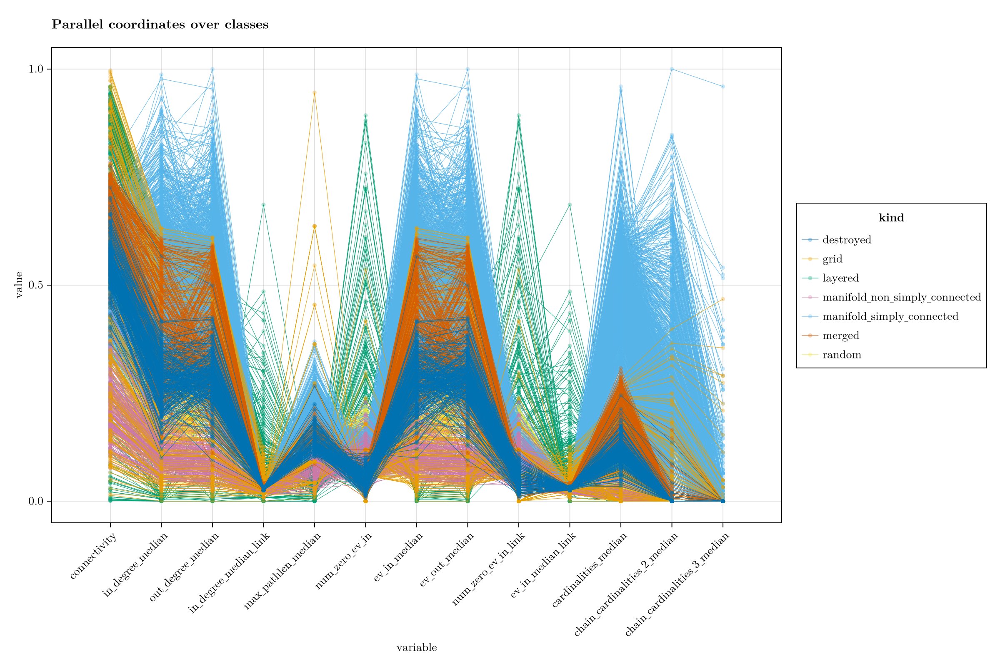

In [159]:
f = draw(sum([layered, random, manifold_simply_connected, manifold_non_simply_connected, grid, merged,destroyed]),  figure=(title="Parallel coordinates over classes", size=(1200, 800)), axis=(xticklabelrotation=pi/4,))

In [ ]:
AlgebraOfGraphics.save("./parallel_coordinates_classes_reduced_layered.png", f)


- dramatically different for degrees statistics, sources, sinks, eigenvalues of graph laplacian (connected to flow from sources, sinks) for the link matrix 
- less so for full TCed adj matrix
- not so much for pathlens
- num_sinks/num_sources is the same as number of zero evs in / out

=> random and manifold like csets are structurally quite different it seems, especially at the boundary (sources, sinks and associated flow structure)

- const curvature data is very similar to polynomial manifold data, but is not completely contained, maybe b/c order 1 is missing (const curvature = 0?)

- the random data is extemely similar to the manifold like data. Maybe b/c of uniform linkage probabilities? it seemst that only the layered ones are architecturally really different.

- layered data is the most diverse, which is somewhat surprising? 